# **Project Name**    - Zomato Restaurant Clustering and Sentiment Analysis



#### **Project Type**    - Unsupervised ML
#### **Contribution**    - Individual
#### **Team Member 1 -** Mukta Raut


# **Project Summary -**

Zomato is an Indian multinational restaurant aggregator and food delivery company founded by Deepinder Goyal and Pankaj Chaddah in 2008. Zomato provides information, menus and user-reviews of restaurants as well as food delivery options from partner restaurants in select cities.
In this project we focus on company and customers. 
This project involves applying two main techniques, clustering and sentiment analysis. Here's a brief summary of each technique:

<b>Clustering:</b> This is a type of unsupervised machine learning technique that groups similar data points together based on their features. In this project, we'll use clustering to group restaurants on Zomato based on various factors such as cuisine, price, location, and rating.

<b>Sentiment analysis:</b> This is a type of natural language processing (NLP) technique that analyzes text data to determine the sentiment, or overall emotional tone, of the text. In this project, we will also use sentiment analysis to determine the sentiment of restaurant reviews on Zomato, which can give you insights into what customers like and dislike about different restaurants.

By combining these two techniques, we can gain a deeper understanding of the Zomato data and extract valuable insights that can help inform restaurant owners and managers on how to improve their businesses. For example, we could find that restaurants in certain clusters tend to have more positive reviews than others, or that certain cuisines are particularly popular among customers.
Overall, a clustering project on the Zomato dataset for Bangalore can be a powerful tool for restaurant owners, managers, and other stakeholders in the city's food industry to make data-driven decisions and improve the quality of their services. By understanding the characteristics and preferences of different restaurant clusters, they can optimize their offerings, marketing strategies, and business operations to better serve their customers and stay ahead of the competition.






# **GitHub Link -**

Provide your GitHub Link here.

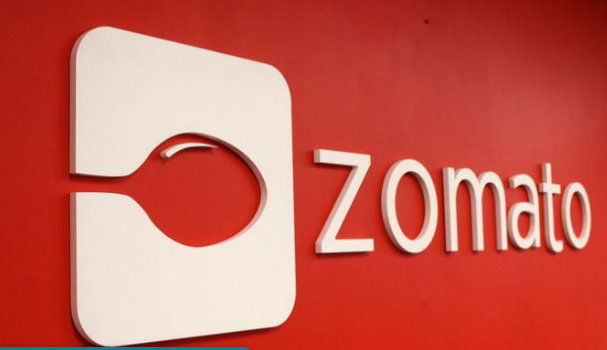

# **Problem Statement**


**The goal of this project is to analyze the Zomato dataset for restaurants and group them into distinct clusters based on their features. The clusters should capture similarities and differences between the restaurants in terms of their cuisine, price range, location, and ratings. The project should apply machine learning techniques, particularly clustering algorithms, to the dataset to identify patterns and trends in the restaurant industry and gain insights into customer preferences and behaviors. The resulting clusters should be visualized and analyzed to provide actionable recommendations to restaurant owners and managers on how to improve their services and meet customer needs more effectively. Additionally, sentiment analysis should be applied to the reviews data to provide a better understanding of the customer feedback and help the restaurants to improve their services.**

# ***Let's Begin !***

## ***1. Know Your Data***

# Zomato Dataset 

### Import Libraries

In [1]:
# Import Libraries
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
import plotly.io as pio
pio.templates.default = "plotly_dark"
# For Notebooks
init_notebook_mode(connected=True)
# For offline use
cf.go_offline()
import seaborn as sns
import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')
# import re
# from nltk.corpus import stopwords
# from sklearn.metrics.pairwise import linear_kernel
# from sklearn.feature_extraction.text import CountVectorizer
# from sklearn.feature_extraction.text import TfidfVectorizer
%matplotlib inline

### Dataset Loading

In [2]:
# Load Dataset
df_one=pd.read_csv("zomatodata.csv")

### Dataset First View

In [3]:
# Dataset First Look
df_one.head()

,Name,Links,Cost,Collections,Cuisines,Timings
0,Beyond Flavours,https://www.zomato.com/hyderabad/beyond-flavou...,800,"Food Hygiene Rated Restaurants in Hyderabad, C...","Chinese, Continental, Kebab, European, South I...","12noon to 3:30pm, 6:30pm to 11:30pm (Mon-Sun)"
1,Paradise,https://www.zomato.com/hyderabad/paradise-gach...,800,Hyderabad's Hottest,"Biryani, North Indian, Chinese",11 AM to 11 PM
2,Flechazo,https://www.zomato.com/hyderabad/flechazo-gach...,"1,300","Great Buffets, Hyderabad's Hottest","Asian, Mediterranean, North Indian, Desserts","11:30 AM to 4:30 PM, 6:30 PM to 11 PM"
3,Shah Ghouse Hotel & Restaurant,https://www.zomato.com/hyderabad/shah-ghouse-h...,800,Late Night Restaurants,"Biryani, North Indian, Chinese, Seafood, Bever...",12 Noon to 2 AM
4,Over The Moon Brew Company,https://www.zomato.com/hyderabad/over-the-moon...,"1,200","Best Bars & Pubs, Food Hygiene Rated Restauran...","Asian, Continental, North Indian, Chinese, Med...","12noon to 11pm (Mon, Tue, Wed, Thu, Sun), 12no..."


### Dataset Rows & Columns count

In [4]:
# Dataset Rows & Columns count
df_one.shape

(105, 6)

### Dataset Information

In [5]:
# Dataset Info
df_one.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105 entries, 0 to 104
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Name         105 non-null    object
 1   Links        105 non-null    object
 2   Cost         105 non-null    object
 3   Collections  51 non-null     object
 4   Cuisines     105 non-null    object
 5   Timings      104 non-null    object
dtypes: object(6)
memory usage: 5.0+ KB


### Insights  

* **There are 105 rows and 6 columns in the dataset.**
* **All the columns have data type 'object'; i.e. non-numeric data type**
* **column named "Collections" have nearly 50% values missing.**
* **Timings column has one missing value** 

#### Duplicate Values

In [6]:
# Dataset Duplicate Value 
df_one.duplicated().value_counts()

False    105
dtype: int64

### Insights
* There are no duplicate entries in the dataset

#### Missing Values/Null Values

In [7]:
# Missing Values/Null Values Count
df_one.isnull().any()

Name           False
Links          False
Cost           False
Collections     True
Cuisines       False
Timings         True
dtype: bool

<AxesSubplot:>

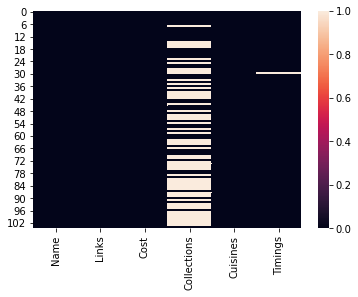

In [8]:
# Visualizing the missing values
sns.heatmap(df_one.isnull())

In [9]:
#replace null values
df_one['Collections'].fillna(method='ffill',inplace=True)

In [10]:
df_one.isna().sum()

Name           0
Links          0
Cost           0
Collections    0
Cuisines       0
Timings        1
dtype: int64

In [11]:
df_one.dropna(inplace=True)

In [12]:
df_one.isna().sum()

Name           0
Links          0
Cost           0
Collections    0
Cuisines       0
Timings        0
dtype: int64

### What did you know about your dataset?

### Data Descripption
**We have following columns in the dataset zomato data - **
1. Name : Name of Restaurants

2. Links : URL Links of Restaurants

3. Cost : Per person estimated Cost of dining

4. Collection : Tagging of Restaurants w.r.t. Zomato categories

5. Cuisines : Cuisines served by Restaurants

6. Timings : Restaurant Timings

## ***2. Understanding Your Variables***

In [13]:
# Dataset Columns
df_one.columns

Index(['Name', 'Links', 'Cost', 'Collections', 'Cuisines', 'Timings'], dtype='object')

In [14]:
# Dataset 
df_one.describe(include="all")

,Name,Links,Cost,Collections,Cuisines,Timings
count,104,104,104,104,104,104
unique,104,104,29,42,91,77
top,Hitech Bawarchi Food Zone,https://www.zomato.com/hyderabad/pourhouse7-ga...,500,Food Hygiene Rated Restaurants in Hyderabad,"North Indian, Chinese",11 AM to 11 PM
freq,1,1,13,14,4,6


In [15]:
pd.set_option('display.max_colwidth', None)
df_one.loc[0:6,['Name','Links']]

,Name,Links
0,Beyond Flavours,https://www.zomato.com/hyderabad/beyond-flavours-gachibowli
1,Paradise,https://www.zomato.com/hyderabad/paradise-gachibowli
2,Flechazo,https://www.zomato.com/hyderabad/flechazo-gachibowli
3,Shah Ghouse Hotel & Restaurant,https://www.zomato.com/hyderabad/shah-ghouse-hotel-restaurant-gachibowli
4,Over The Moon Brew Company,https://www.zomato.com/hyderabad/over-the-moon-brew-company-gachibowli
5,The Fisherman's Wharf,https://www.zomato.com/hyderabad/the-fishermans-wharf-gachibowli
6,eat.fit,https://www.zomato.com/hyderabad/eat-fit-gachibowli


In [16]:
pd.set_option('display.max_colwidth', None)
df_one.loc[50:54,['Name','Links']]

,Name,Links
50,Gal Punjab Di,https://www.zomato.com/hyderabad/gal-punjab-di-gachibowli
51,Hitech Bawarchi Food Zone,https://www.zomato.com/hyderabad/hitech-bawarchi-food-zone-gachibowli
52,Biryanis And More,https://www.zomato.com/hyderabad/biryanis-and-more-gachibowli
53,Diners Pavilion,https://www.zomato.com/hyderabad/diners-pavilion-gachibowli
54,Asian Meal Box,https://www.zomato.com/hyderabad/asian-meal-box-gachibowli


### Check Unique Values for each variable. 

In [17]:
#find out the reson why Cost column has datatype object
df_one['Cost'].unique()

array(['800', '1,300', '1,200', '1,500', '500', '300', '1,000', '350',
       '400', '1,600', '750', '550', '1,900', '450', '150', '1,400',
       '1,100', '600', '200', '700', '900', '1,700', '2,500', '850',
       '650', '1,800', '2,800', '1,750', '250'], dtype=object)

**The variables' description is as follows - **
### Data Description
**We have following columns in the dataset zomato data - **
1. Name : * It contains name of Restaurants. 
            * Data type - Object
            * unique values - 105 (there are no duplicate entries)
            

2. Links : URL Links of Restaurants
            * It contains links of the restaurant.
            * each link contain domain name (zomato.com) and restaurant name with common suffix - gachibowli

3. Cost : Per person estimated Cost of dining
            * Although the values are numerical, the data type is object. This is due to the commas used in the cost.

4. Collection : Tagging of Restaurants w.r.t. Zomato categories
            * There are 42 unique categories in which all restaurants are tagged.
            * This is again object datatype column.

5. Cuisines : Cuisines served by Restaurants
            * Most restaurants have multuiple cuisines
            * data type is object

6. Timings : Restaurant Timings

# Data Wrangling 
**Lets make our dataset ready for data analysis**

**Column Links do not give us any new information about the dataset. So we can safely delete the column from our dataset.**

In [21]:
df_one = df_one.drop(['Links'], axis=1)

**Column Price is categorized as object, due to a comma in the price. Let us perform data cleaning to convert it into an integer**

In [22]:
df_one['Cost']=df_one['Cost'].str.replace(",","").astype('int64')

In [23]:
df_one['Cost'].dtype

dtype('int64')

In [24]:
df_one.head()

,Name,Cost,Collections,Cuisines,Timings
0,Beyond Flavours,800,"Food Hygiene Rated Restaurants in Hyderabad, Corporate Favorites, Great Buffets, Top-Rated, Gold Curated, Live Sports Screenings","Chinese, Continental, Kebab, European, South Indian, North Indian","12noon to 3:30pm, 6:30pm to 11:30pm (Mon-Sun)"
1,Paradise,800,Hyderabad's Hottest,"Biryani, North Indian, Chinese",11 AM to 11 PM
2,Flechazo,1300,"Great Buffets, Hyderabad's Hottest","Asian, Mediterranean, North Indian, Desserts","11:30 AM to 4:30 PM, 6:30 PM to 11 PM"
3,Shah Ghouse Hotel & Restaurant,800,Late Night Restaurants,"Biryani, North Indian, Chinese, Seafood, Beverages",12 Noon to 2 AM
4,Over The Moon Brew Company,1200,"Best Bars & Pubs, Food Hygiene Rated Restaurants in Hyderabad, Top-Rated, Gold Curated, Hyderabad's Hottest","Asian, Continental, North Indian, Chinese, Mediterranean","12noon to 11pm (Mon, Tue, Wed, Thu, Sun), 12noon to 12midnight (Fri-Sat)"


# lets us do univariate, bivariate and multivariate analysis on Zomato data dataset

# Chart 1
# Univariate analysis 

In [25]:
df_one['Cost'].iplot(kind='hist',bins=10, title='Distribution - Cost',theme="space")

## Why we selected this plot?
**In univariate analysis, we are mainly interested in the distribution of data. Histogram helps us to show distribution of a column with continuous values**

## Visualizations
**The cost column do not have norml distribution. So we need to change the distribution to normal. We can do this by using log transformation.**

In [26]:
import plotly.express as px
for i in df_one.columns:
    df_one[i].iplot(kind='hist',bins=10, title=i, theme="space",colorscale='ylorrd')

# Bivariate Analysis

**Let us perform bivariate analysis on the zomato dataset**

In [27]:
df_one.columns

Index(['Name', 'Cost', 'Collections', 'Cuisines', 'Timings'], dtype='object')

In [28]:
cf.tools.getThemes()

['ggplot', 'pearl', 'solar', 'space', 'white', 'polar', 'henanigans']

# Chart 2

In [29]:
df_one.iplot(x="Name",y='Cost', title="Per person dining cost of each Restaurant ", theme='solar',colorscale='plotly')

## why did you select this chart?
**Line plot for cost and restaurant will help us get the Restaurant with higest dining cost per person**

## Visualizations
* **Most costly Restaurant is Collage - Hyatt Hydrabad Gachalbowli ; Cost per person is Rs. 2800**
* **Least costly restaurants are Mohammedia Shawarma and Amul ; Cost per person is 150**

## Chart 3 

In [30]:
Top10Costly = df_one[['Name','Cost']].groupby('Name').sum().sort_values(by='Cost',ascending=False).head(10)

In [31]:
Top10Costly

,Cost
Name,
Collage - Hyatt Hyderabad Gachibowli,2800
Feast - Sheraton Hyderabad Hotel,2500
10 Downing Street,1900
Jonathan's Kitchen - Holiday Inn Express & Suites,1900
Cascade - Radisson Hyderabad Hitec City,1800
Zega - Sheraton Hyderabad Hotel,1750
Republic Of Noodles - Lemon Tree Hotel,1700
Mazzo - Marriott Executive Apartments,1700
Barbeque Nation,1600


In [32]:
Top10Costly.iplot(kind='bar',colorscale='plotly',theme='solar',title='Top 10 Expensive Restaurants')

## Chart 4

In [33]:
Top10BF = df_one[['Name','Cost']].groupby('Name').sum().sort_values(by='Cost',ascending=True).head(10)

In [34]:
Top10BF.iplot(kind='bar',colorscale='plotly',theme='solar',title='Top 10 Budget Friendly Restaurants')

# Chart 5

In [35]:
import plotly.express as px
fig1 = px.scatter(df_one,x=df_one['Cuisines'], y=df_one['Cost'],color=df_one['Name'],orientation='h',height=800,title='Cost per persons vs. Cuisines served')
fig1.show()

## Here we can see that the most costly restaurant servers following cuisines-
* continental
* italian
* North Indian
* Asian
* Mordern Indian
* Japnese
* Sushi
* salad
* Chinese

## The budget-friendly restaurants, on the other hand serve following Cuisines - 
* Icecream 
* Deserts 
* Bakery 
* Fastfood 
* Asian 
* Momos 
* Streetfood 
* Arabian 
* Mithai

### Now to analyze Collections column, we need to carry out some textual data processing. For this we can use nltk module

In [36]:
import pandas as pd
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

# Load the Pandas DataFrame
# df = pd.read_csv('my_data.csv')

# Define the text preprocessing pipeline
stop_words = stopwords.words('english')
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    nltk.download('punkt')

# = "This is an example text with 1.23 and 4.56 float values that need to be removed."

# Define a regex pattern to match float values
    pattern = r'\d+\.\d+'

# Remove float values from the text
    text_without_floats = re.sub(pattern, '', text)

# Tokenize the text to check the result
    tokens = nltk.word_tokenize(text_without_floats)
#print(tokens)
#In this example, we define a regex pattern \d+\.\d+ that matches float values in the text. We use the re.sub() function to replace all occurrences of the pattern with an empty string, effectively removing the float values from the text. Finally, we tokenize the text using the nltk.word_tokenize() function to check the result. The output should be ['This', 'is', 'an', 'example', 'text', 'with', 'and', 'float', 'values', 'that', 'need', 'to', 'be', 'removed', '.'], which does not contain any float values.



    tokens = ' '.join([str(elem) for elem in tokens])

    # Convert the text to lowercase
    tokens = tokens.lower()
    # Remove punctuation
    tokens = ''.join(c for c in text if not c.isalnum() and not c.isspace())
    # Remove stopwords
    tokens = ' '.join([word for word in text.split() if word not in stop_words])
    # Lemmatize the words
    tokens = ' '.join([lemmatizer.lemmatize(word) for word in text.split()])
    return tokens



[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [37]:
df_one.Collections.isna().sum()

0

In [38]:
df_one.dropna(inplace=True)

In [39]:
# Apply the preprocessing pipeline on the 'text' column of the DataFrame
df_one['Collections'] = df_one['Collections'].apply(preprocess_text)


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\R

In [40]:
df_one['Cuisines'] = df_one['Cuisines'].apply(preprocess_text)


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Yogesh\AppData\R

In [41]:
df_one.head()

,Name,Cost,Collections,Cuisines,Timings
0,Beyond Flavours,800,"Food Hygiene Rated Restaurants in Hyderabad, Corporate Favorites, Great Buffets, Top-Rated, Gold Curated, Live Sports Screenings","Chinese, Continental, Kebab, European, South Indian, North Indian","12noon to 3:30pm, 6:30pm to 11:30pm (Mon-Sun)"
1,Paradise,800,Hyderabad's Hottest,"Biryani, North Indian, Chinese",11 AM to 11 PM
2,Flechazo,1300,"Great Buffets, Hyderabad's Hottest","Asian, Mediterranean, North Indian, Desserts","11:30 AM to 4:30 PM, 6:30 PM to 11 PM"
3,Shah Ghouse Hotel & Restaurant,800,Late Night Restaurants,"Biryani, North Indian, Chinese, Seafood, Beverages",12 Noon to 2 AM
4,Over The Moon Brew Company,1200,"Best Bars & Pubs, Food Hygiene Rated Restaurants in Hyderabad, Top-Rated, Gold Curated, Hyderabad's Hottest","Asian, Continental, North Indian, Chinese, Mediterranean","12noon to 11pm (Mon, Tue, Wed, Thu, Sun), 12noon to 12midnight (Fri-Sat)"


## Chart 6  - word cloud for Cuisines

(-0.5, 1799.5, 1399.5, -0.5)

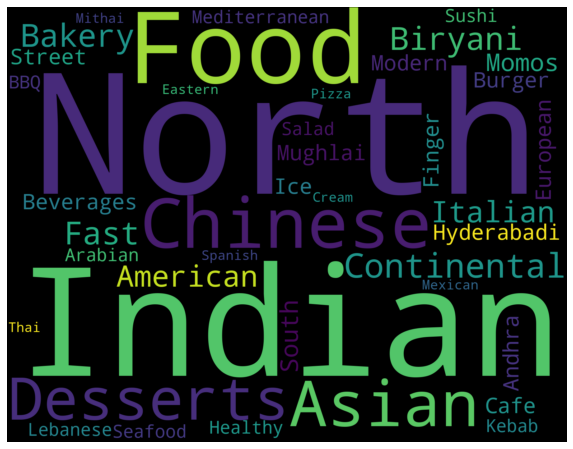

In [42]:
from wordcloud import WordCloud
from collections import Counter 
text = ' '.join(df_one['Cuisines'])
words = text.split()

two_words = {' '.join(words):n for words,n in Counter(zip(words, words[1:])).items() if not  words[0][-1]==(',')}


word_freq = pd.DataFrame(two_words.items(), columns=['Cuisine_Words', 'Frequency'])
word_freq = word_freq.sort_values(by = "Frequency", ascending = False)
word_freq_20 = word_freq[:20]

#Wordcloud for Cuisine
plt.figure(figsize=(15,8))
text = " ".join(name for name in word_freq.Cuisine_Words )


# Creating word_cloud with text as argument in .generate() method

word_cloud = WordCloud(width = 1800, height = 1400,collocations = False, background_color = 'black').generate(text)

# Display the generated Word Cloud

plt.imshow(word_cloud, interpolation='bilinear')

plt.axis("off")

## Chart 7 - word cloud for Collections

(-0.5, 1999.5, 1499.5, -0.5)

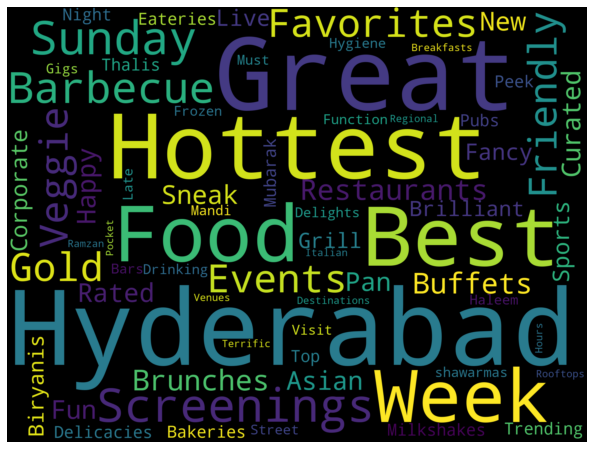

In [43]:
from collections import Counter 
text = ' '.join(df_one['Collections'])
words = text.split()

two_words = {' '.join(words):n for words,n in Counter(zip(words, words[1:])).items() if not  words[0][-1]==(',')}


word_freq = pd.DataFrame(two_words.items(), columns=['Cuisine_Words', 'Frequency'])
word_freq = word_freq.sort_values(by = "Frequency", ascending = False)
word_freq_20 = word_freq[:20]

#Wordcloud for Cuisine
plt.figure(figsize=(15,8))
text = " ".join(name for name in word_freq.Cuisine_Words )


# Creating word_cloud with text as argument in .generate() method

word_cloud = WordCloud(width = 2000, height = 1500,collocations = False, background_color = 'black').generate(text)

# Display the generated Word Cloud

plt.imshow(word_cloud, interpolation='bilinear')

plt.axis("off")

In [44]:
# Convert the 'Values' column into a list
df_one['Cuisines'] = df_one['Cuisines'].str.split(',')

# Use the explode() function on the 'Values' column
df_exploded = df_one.explode('Cuisines')

# Print the result


In [45]:
df_exploded.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 310 entries, 0 to 104
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Name         310 non-null    object
 1   Cost         310 non-null    int64 
 2   Collections  310 non-null    object
 3   Cuisines     310 non-null    object
 4   Timings      310 non-null    object
dtypes: int64(1), object(4)
memory usage: 14.5+ KB


In [46]:
#df_exploded.groupby('Cuisines').sum()
s = df_exploded.groupby(["Cuisines", "Name"], group_keys=True)

In [47]:
s.max()

Cost  \
Cuisines     Name                                           
 American    Absolute Sizzlers                        750   
             GD's                                     500   
 Andhra      Banana Leaf Multicuisine Restaurant      700   
             Owm Nom Nom                              900   
             T Grill                                  700   
...                                                   ...   
South Indian Mathura Vilas                            500   
             Udipi's Upahar                           500   
Street Food  Mohammedia Shawarma                      150   
             Sardarji's Chaats & More                 400   
Thai         Republic Of Noodles - Lemon Tree Hotel  1700   

                                                                                       Collections  \
Cuisines     Name                                                                                    
 American    Absolute Sizzlers                                                       Great Buffets   
             GD's                                                               Brilliant Biryanis   
 Andhra      Banana Leaf Multicuisine Restaurant                                     Great Buffets   
             Owm Nom Nom                                         Great Buffets, Trending This Week   
             T Grill                                                            Brilliant Biryanis   
...                                                                                            ...   
South Indian Mathura Vilas                                        Veggie Friendly, Terrific Thalis   
             Udipi's Upahar                                                   Pan-Asian Delicacies   
Street Food  Mohammedia Shawarma                       Food Hygiene Rated Restaurants in Hyderabad   
             Sardarji's Chaats & More                Street Food, Veggie Friendly, Pocket Friendly   
Thai         Republic Of Noodles - Lemon Tree Hotel                           Pan-Asian Delicacies   

                                                                                      Timings  
Cuisines     Name                                                                              
 American    Absolute Sizzlers                                               11:30 AM to 1 AM  
             GD's                                                            11:30 AM to 5 AM  
 Andhra      Banana Leaf Multicuisine Restaurant        12:30 PM to 3:30 PM, 7 PM to 10:40 PM  
             Owm Nom Nom                                          12Noon to 11:30PM (Mon-Sun)  
             T Grill                                       12:30 PM to 3:30 PM, 7 PM to 11 PM  
...                                                                                       ...  
South Indian Mathura Vilas                           11:30 AM to 3:30 PM, 6:45 PM to 11:30 PM  
             Udipi's Upahar                                                  6 AM to 10:30 PM  
Street Food  Mohammedia Shawarma                                                 1 PM to 1 AM  
             Sardarji's Chaats & More                    12 Noon to 3:30 PM, 7 PM to 10:30 PM  
Thai         Republic Of Noodles - Lemon Tree Hotel     11:30 AM to 3 PM, 7 PM to 12 Midnight  

[310 rows x 3 columns]

# Know your Data - Reviews dataset


In [48]:
#read the data
df_reviews = pd.read_csv("Zomatoreviews.csv")

# Data first view

In [49]:
df_reviews.head()

,Restaurant,Reviewer,Review,Rating,Metadata,Time,Pictures
0,Beyond Flavours,Rusha Chakraborty,"The ambience was good, food was quite good . had Saturday lunch , which was cost effective .\nGood place for a sate brunch. One can also chill with friends and or parents.\nWaiter Soumen Das was really courteous and helpful.",5,"1 Review , 2 Followers",5/25/2019 15:54,0
1,Beyond Flavours,Anusha Tirumalaneedi,Ambience is too good for a pleasant evening. Service is very prompt. Food is good. Over all a good experience. Soumen Das - kudos to the service,5,"3 Reviews , 2 Followers",5/25/2019 14:20,0
2,Beyond Flavours,Ashok Shekhawat,A must try.. great food great ambience. Thnx for the service by Pradeep and Subroto. My personal recommendation is Penne Alfredo Pasta:) ....... Also the music in the background is amazing.,5,"2 Reviews , 3 Followers",5/24/2019 22:54,0
3,Beyond Flavours,Swapnil Sarkar,"Soumen das and Arun was a great guy. Only because of their behavior and sincerety, And good food off course, I would like to visit this place again.",5,"1 Review , 1 Follower",5/24/2019 22:11,0
4,Beyond Flavours,Dileep,Food is good.we ordered Kodi drumsticks and basket mutton biryani. All are good. Thanks to Pradeep. He served well. We enjoyed here. Ambience is also very good.,5,"3 Reviews , 2 Followers",5/24/2019 21:37,0


In [50]:
df_reviews.tail()

,Restaurant,Reviewer,Review,Rating,Metadata,Time,Pictures
9995,Chinese Pavilion,Abhishek Mahajan,"Madhumathi Mahajan Well to start with nice courteous servers and staff. Excellent serving time, all items arrived on time infact for a change had folks asking if we want to hold a little while before getting next dish out? These things matter a lot when u r paying to eat out.\n\nNow food - Jade chicken soup, nice spinach based creamy stuff, gud way to start the meal. Accompanied by house salad of cabbage and cucumber kimchi, nice dressing but cabbage cut could have been good. Fish cakes were good, loved it and accompanying sauces were awesome. Main course was Mix XO rice of chicken and prawn, well that was the downer. Nothing exciting abt it, maybe shld have coupled with a curry but then Nash, fried rice u shld be able to enjoy dry. Desert - blue berry cheesecake, so here is where me and wifey differ, I thght it was worth it, she says the base wasn't crunchy engh. So try and rate yourself.\n\nLast ambience - was warm n eye soothing.\n\nOh and I forgot, the orange pekoe tea, the best I had in lat few months. Have it",3,"53 Reviews , 54 Followers",6/5/2016 0:08,0
9996,Chinese Pavilion,Sharad Agrawal,"This place has never disappointed us.. The food, the courteous staff, the serene ambience.. We wanted to have something totally rice free and with very little oil. They served us Steamed Fish with chilly garlic noodles with Chicken. As always it was awesome.. Thanks Chinese Pavilion, it is always a pleasant experience!",4.5,"2 Reviews , 53 Followers",6/4/2016 22:01,0
9997,Chinese Pavilion,Ramandeep,"Bad rating is mainly because of ""Chicken Bone found in Veg food"" and is not acceptable for a Vegetarian.\n\nTo satiate Cravings for chinese food we headed to Chinese Pavilion and there was also a voucher available in Little app for Luncheon tray for Rs 310 (Veg) [well do not bother for the voucher as the price for Veg Luncheon tray is Rs 275/- + taxes in the restaurant itself).\n\nThe ambiance is decent and since it was noon, not many tables occupied so it was pretty quite.\n\nIt was Thrusday special (Veg):\nHot and Sour soup: was just OK - well it had sprouts which were crunchy in your mouth: something different.\nKimchi - salad (personally i'm never fond of it)\nPotato in plum sauce - this was very good and well made\nBrocolli, Baby corn, Mushroom in spicy sauce - this dish lived to its name 'too spicy'; but was fine with fried rice\nVeg hakka noodles - was good\nVeg fried rice\n\nOverall the food tasted good until a piece of chicken BONE came into my friend's (he is pure vegetarian) mouth while eating noodles. It was such a disappointment and complete experience was ruined.\nWell Management did apologise but surely they cannot put things correct and were offering of not using coupon but we surely don't want to visit the place again. I requested to see their kitchen if they really segregate pans for Veg/Non-veg cooking which Manager declined which makes me believe they don't.\n\nStaff and service are fine but they really need to improve the segregation of Veg and Non-veg as in Indian Culture it means a lot.\n\nUploaded photos with the bone found.",1.5,"65 Reviews , 423 Followers",6/3/2016 10:37,3
9998,Chinese Pavilion,Nayana Shanbhag,"I personally love and prefer Chinese Food. Had been here couple of times with my husband.\n\nThe ambiance of the place is very good. The entrance has some carvings and the walls were very nicely decorated. The server was very polite\n\nWhen it comes to food this place does not disappoint.This is a small/comfy restaurant that is surprisingly not very crowded even on weekends. \n\nWe went there for our anniversary celebrations and it was just perfect. No crowd, we got the attention and service we were looking for.",4,"13 Reviews , 144 Followers",5/31/2016 17:22,0
9999,Chinese Pavilion,Bhargava Krishna,"Checked in here to try some delicious chinese food here, seen non-veg luncheon tray menu ans tried the same 

# dataset rows and columns

In [51]:
df_reviews.shape

(10000, 7)

# Dataset information

In [52]:
df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Restaurant  10000 non-null  object
 1   Reviewer    9962 non-null   object
 2   Review      9955 non-null   object
 3   Rating      9962 non-null   object
 4   Metadata    9962 non-null   object
 5   Time        9962 non-null   object
 6   Pictures    10000 non-null  int64 
dtypes: int64(1), object(6)
memory usage: 547.0+ KB


# Insights
* There are 10000 rows and 7 coulmns in dataset.
* There are null values in columns Reviewer, Review, Rating, Metadata and Time
* All columns have object data type except Pictures column which has numerical value


# Duplicate values and NULL values

In [53]:
df_reviews.duplicated().sum()

36

In [54]:
df_reviews=df_reviews.drop_duplicates()

In [55]:
df_reviews.duplicated().sum()

0

## The NULL values in each column are as follows

In [56]:
# check the null values in each column in dataset
print(pd.DataFrame(df_reviews.isnull()).sum())

Restaurant    0
Reviewer      2
Review        9
Rating        2
Metadata      2
Time          2
Pictures      0
dtype: int64


## In entire dataset, there are 36 duplicate values.

In [57]:
df_reviews.describe(include="all")

,Restaurant,Reviewer,Review,Rating,Metadata,Time,Pictures
count,9964,9962,9955,9962,9962,9962,9964.000000
unique,100,7446,9364,10,2477,9782,NaN
top,Royal Spicy Restaurant,Ankita,good,5,1 Review,5/14/2019 23:44,NaN
freq,100,13,237,3832,919,3,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,0.751305
std,NaN,NaN,NaN,NaN,NaN,NaN,2.574626
min,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,0.000000


#  Check Unique Values for each variable

In [58]:
# Check Unique Values for each variable.
a=list(df_reviews.columns)
for i in a:
    print(f"The unique values in {i} are -  {df_reviews[i].nunique()}")

The unique values in Restaurant are -  100
The unique values in Reviewer are -  7446
The unique values in Review are -  9364
The unique values in Rating are -  10
The unique values in Metadata are -  2477
The unique values in Time are -  9782
The unique values in Pictures are -  36


## 3. ***Data Wrangling***

### Data Wrangling Code

In [59]:
# Write your code to make your dataset analysis ready.
df_reviews.loc[df_reviews['Rating'] == 'Like'] = np.nan
df_reviews['Rating']= df_reviews['Rating'].astype('float64')

In [60]:
print(df_reviews['Rating'].mean())

3.601044071880333


# Feature engineering and data wrangling

In [61]:
# we can replace the null values in Rating columns with the mean
df_reviews['Rating'].fillna(3.6, inplace=True)

In [62]:
# split metadata column into 2 columns i.e. Reviews and followers
df_reviews['Reviews'],df_reviews['Followers']= df_reviews['Metadata'].str.split(',').str
df_reviews['Reviews'] = pd.to_numeric(df_reviews['Reviews'].str.split(' ').str[0])

In [63]:
df_reviews['Followers']= pd.to_numeric(df_reviews['Followers'].str.split(' ').str[1])

In [64]:
# Converting Time column into Time, Year, Month, Hour
df_reviews['Time']=pd.to_datetime(df_reviews['Time'])
df_reviews['Year'] = pd.DatetimeIndex(df_reviews['Time']).year
df_reviews['Month'] = pd.DatetimeIndex(df_reviews['Time']).month
df_reviews['Hour'] = pd.DatetimeIndex(df_reviews['Time']).hour
df_reviews = df_reviews.drop(['Metadata'], axis =1)

# Find out null values

In [65]:
df_reviews.isnull().sum()

Restaurant       1
Reviewer         3
Review          10
Rating           0
Time             3
Pictures         1
Reviews          3
Followers     1581
Year             3
Month            3
Hour             3
dtype: int64

# Impute the NULL values

In [66]:
# Replacing followers and reviews null values into 0
df_reviews['Followers'].fillna(0,inplace=True)
df_reviews['Reviews'].fillna(0,inplace=True)

## We can delete remaining null values as they are very few

In [67]:
df_reviews.dropna(inplace=True)
df_reviews.reset_index(inplace = True)
df_reviews.isnull().sum()

index         0
Restaurant    0
Reviewer      0
Review        0
Rating        0
Time          0
Pictures      0
Reviews       0
Followers     0
Year          0
Month         0
Hour          0
dtype: int64

In [68]:
df_reviews.head()

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour
0,0,Beyond Flavours,Rusha Chakraborty,"The ambience was good, food was quite good . had Saturday lunch , which was cost effective .\nGood place for a sate brunch. One can also chill with friends and or parents.\nWaiter Soumen Das was really courteous and helpful.",5.0,2019-05-25 15:54:00,0.0,1.0,2.0,2019.0,5.0,15.0
1,1,Beyond Flavours,Anusha Tirumalaneedi,Ambience is too good for a pleasant evening. Service is very prompt. Food is good. Over all a good experience. Soumen Das - kudos to the service,5.0,2019-05-25 14:20:00,0.0,3.0,2.0,2019.0,5.0,14.0
2,2,Beyond Flavours,Ashok Shekhawat,A must try.. great food great ambience. Thnx for the service by Pradeep and Subroto. My personal recommendation is Penne Alfredo Pasta:) ....... Also the music in the background is amazing.,5.0,2019-05-24 22:54:00,0.0,2.0,3.0,2019.0,5.0,22.0
3,3,Beyond Flavours,Swapnil Sarkar,"Soumen das and Arun was a great guy. Only because of their behavior and sincerety, And good food off course, I would like to visit this place again.",5.0,2019-05-24 22:11:00,0.0,1.0,1.0,2019.0,5.0,22.0
4,4,Beyond Flavours,Dileep,Food is good.we ordered Kodi drumsticks and basket mutton biryani. All are good. Thanks to Pradeep. He served well. We enjoyed here. Ambience is also very good.,5.0,2019-05-24 21:37:00,0.0,3.0,2.0,2019.0,5.0,21.0


In [69]:
df_reviews.describe(include="all")

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour
count,9954.000000,9954,9954,9954,9954.000000,9954,9954.000000,9954.000000,9954.000000,9954.000000,9954.000000,9954.000000
unique,NaN,100,7442,9363,NaN,9774,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Royal Spicy Restaurant,Parijat Ray,good,NaN,2019-05-05 22:39:00,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,100,13,237,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,NaN,2016-05-31 16:41:00,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,2019-05-25 20:23:00,NaN,NaN,NaN,NaN,NaN,NaN
mean,4983.199920,NaN,NaN,NaN,3.600261,NaN,0.751959,24.007937,163.122363,2018.452381,6.017079,15.183946
std,2882.485546,NaN,NaN,NaN,1.483573,NaN,2.575819,50.631674,620.182806,0.562566,3.160515,6.580345
min,0.000000,NaN,NaN,NaN,1.000000,NaN,0.000000,0.000000,0.000000,2016.000000,1.000000,0.000000
25%,2489.250000,NaN,NaN,NaN,3.000000,NaN,0.000000,1.000000,1.000000,2018.000000,4.000000,12.000000


### What all manipulations have you done and insights you found?

* **In Feature engineering, we have split the column 'metadata' into two columns, 'reviews' and 'followers'**
* **Then we have split the time column which contains datetime information into time, day, month, year and hour columns, which will give us lot more insights than the original columns.**

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Chart - 1

                                             |                                             | [  0%]   00:00 ->…


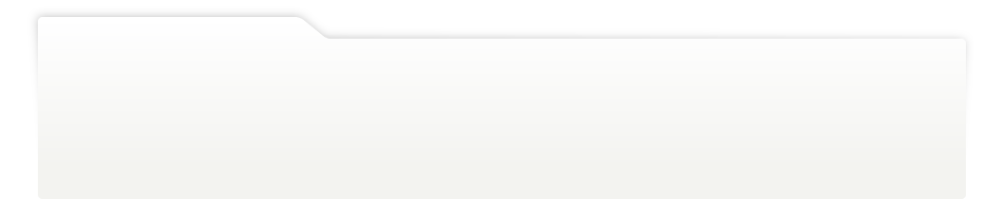
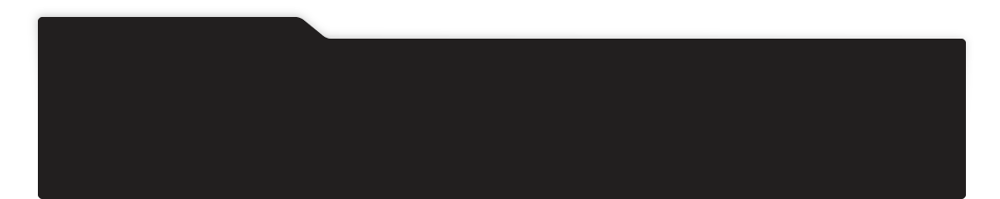
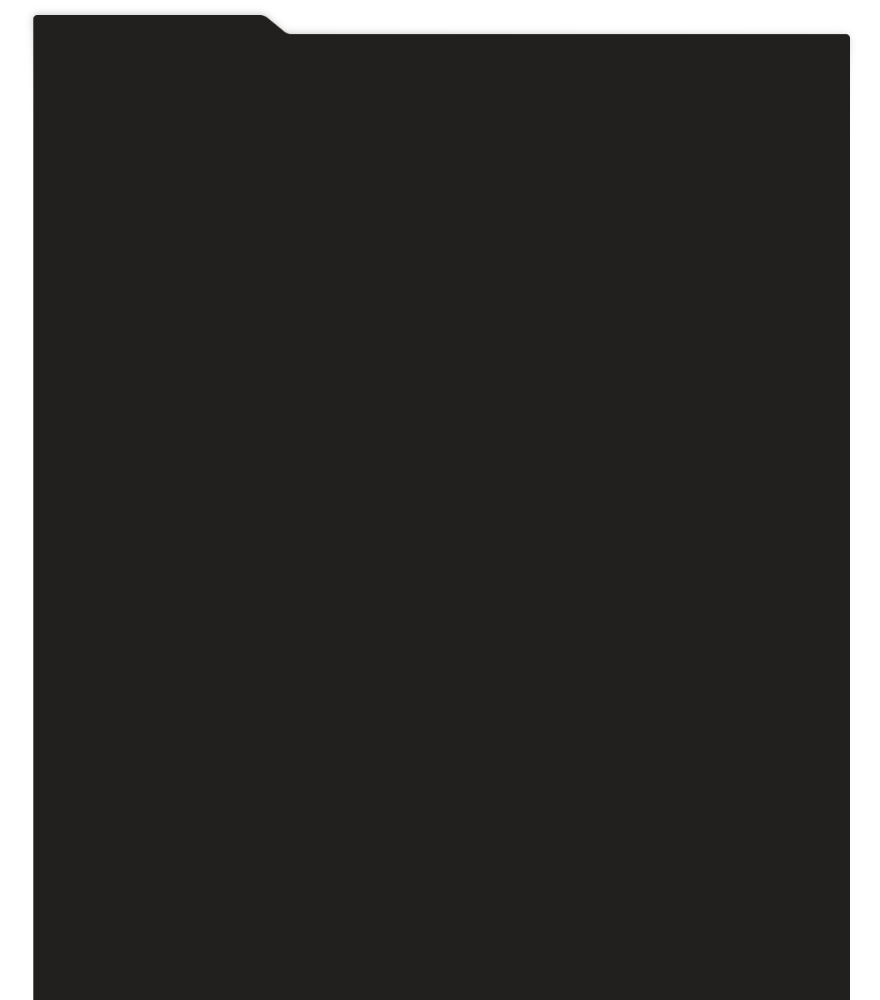
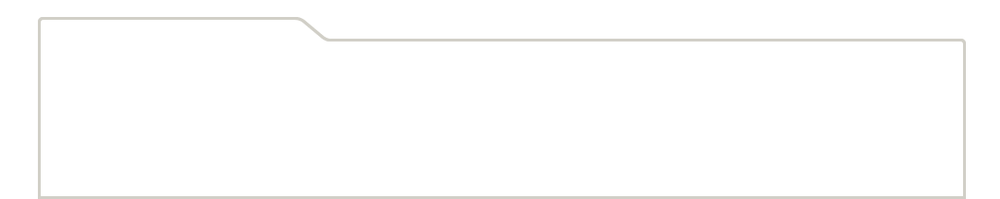
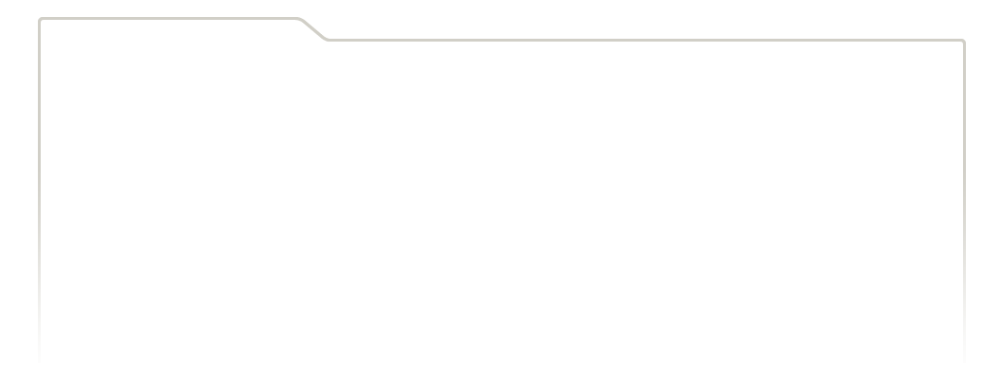
...
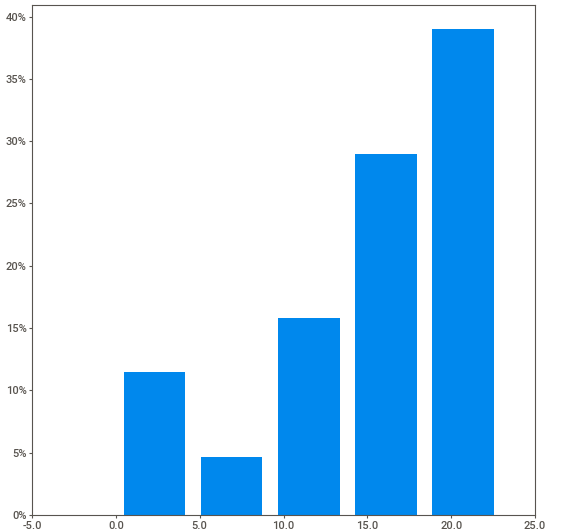
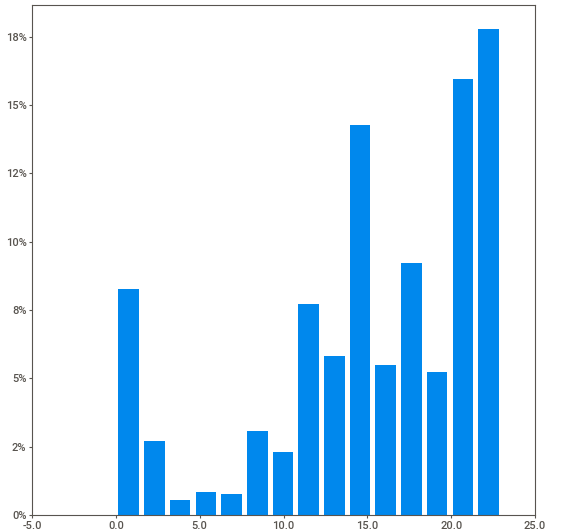
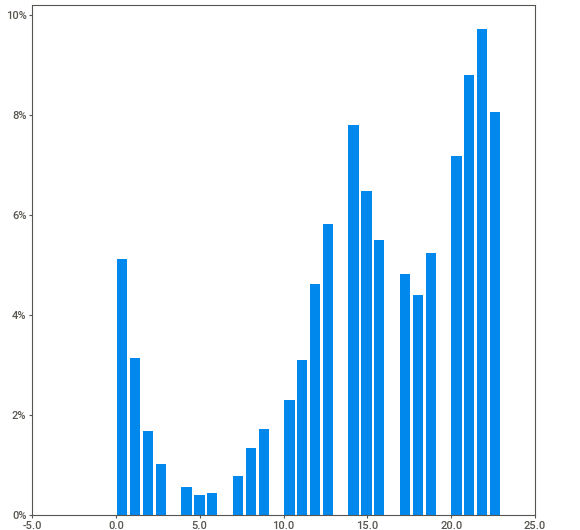
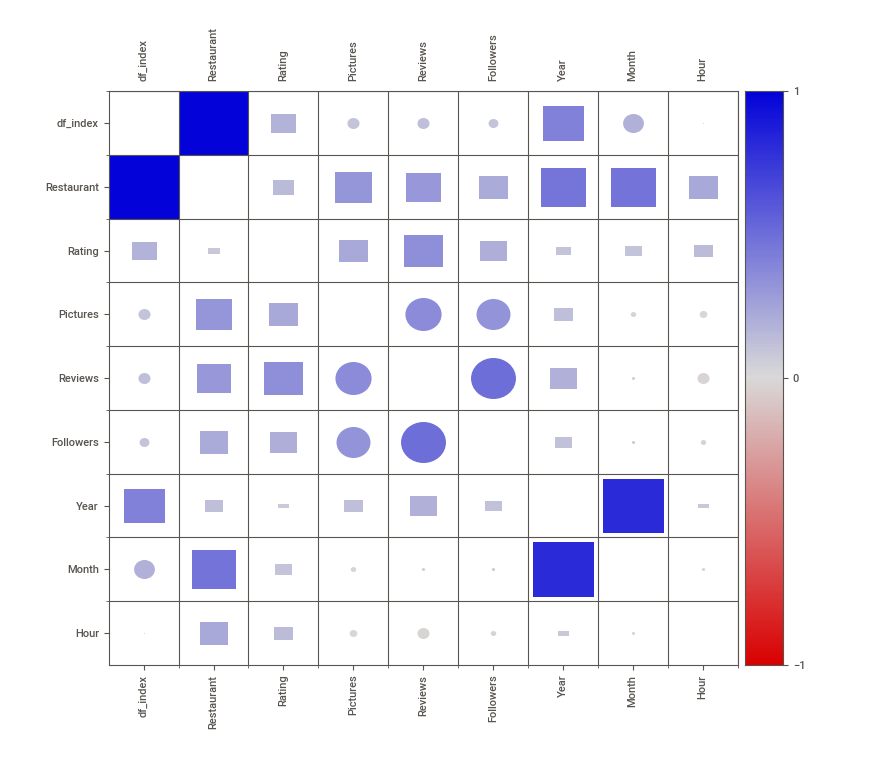
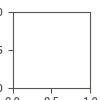

In [70]:
# Chart - 1 visualization code
import sweetviz as sv
detailedreport = sv.analyze(df_reviews)
detailedreport.show_notebook(layout='vertical', w=800, h=300, scale=0.7)

##### 1. Why did you pick the specific chart?

* **This chart gives us detailed univariate analysis of our entire dataset.**
* **We also get the associations of one varible with respect to all other variables**
* ***This makes the sweetviz visualization report a very interesting data visualization module***

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact? 
Are there any insights that lead to negative growth? Justify with specific reason.

These insights are very valuable for our entire clustering and sentiment analysis problem.

#### Chart - 2 Group by reviewers by maximum no. of ratings

In [71]:
# to find out the top reviewrs, we  will first create a list of all the reviewers
reviewer_list = df_reviews.groupby('Reviewer').apply(lambda x: x['Reviewer'].count()).reset_index(name='Review_Count')
reviewer_list = reviewer_list.sort_values(by = 'Review_Count',ascending=False)
top_reviewers = reviewer_list[:15]
top_reviewers.head()

,Reviewer,Review_Count
654,Ankita,13
3855,Parijat Ray,13
2652,Kiran,12
7009,Vedant Killa,11
2311,Jay Mehta,11


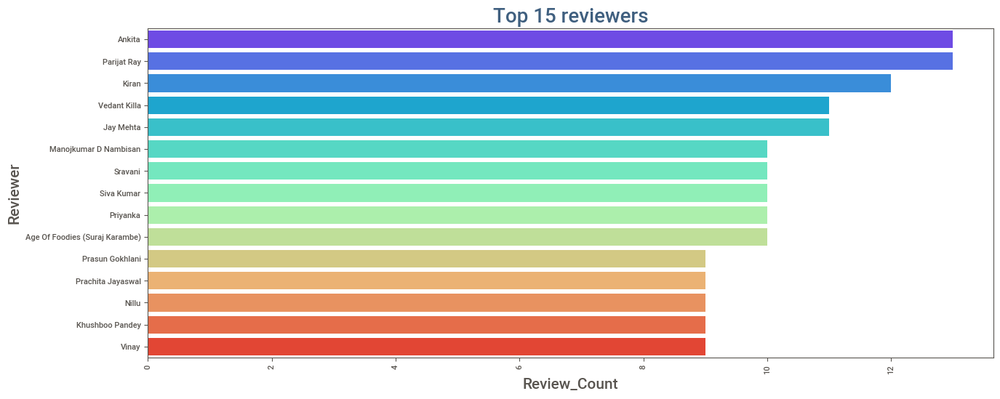

In [72]:
# Chart - 2 visualization code
# top reviewers that have more review
plt.figure(figsize=(15,6))
x = top_reviewers['Review_Count']
y = top_reviewers['Reviewer']
plt.title("Top 15 reviewers",fontsize=20, weight='bold',color=sns.cubehelix_palette(8, start=.5, rot=-.75)[-3])
plt.ylabel("Name",weight='bold',fontsize=15)
plt.xlabel("No. of Reviews",weight='bold',fontsize=15)
plt.xticks(rotation=90)
sns.barplot(x=x, y=y,palette='rainbow')
plt.show()



##### 1. Why did you pick the specific chart?

**We picked this specific chart to clearly visualiza top 15 reviewers from the dataset**

#### Chart - 3 Group by the reviewrs who give average ratings to the restaurants

In [73]:
# Average of the ratings of reviewers with review count
review_ratings=df_reviews.groupby('Reviewer').apply(lambda x:np.average(x['Rating'])).reset_index(name='AverageRatings')
review_ratings=pd.merge(top_reviewers,review_ratings,how='inner',left_on='Reviewer',right_on='Reviewer')
top_reviewers_ratings=review_ratings[:15]
top_reviewers_ratings=top_reviewers_ratings.sort_values(by = 'AverageRatings',ascending=False)
top_reviewers_ratings.head()

,Reviewer,Review_Count,AverageRatings
2,Kiran,12,4.500000
11,Prachita Jayaswal,9,4.333333
3,Vedant Killa,11,4.000000
6,Sravani,10,4.000000
10,Prasun Gokhlani,9,4.000000


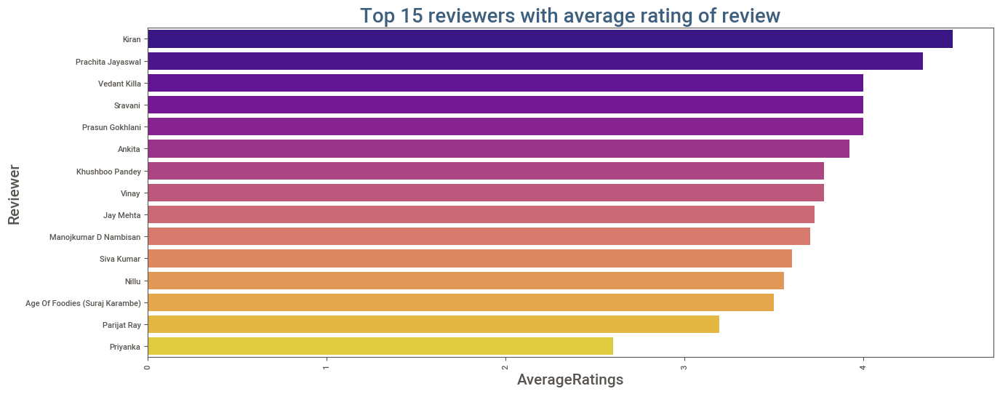

In [74]:
# Chart - 3 visualization code
# Average rating of top reviewers
plt.figure(figsize=(15,6))
x = top_reviewers_ratings['AverageRatings']
y = top_reviewers_ratings['Reviewer']
plt.title("Top 15 reviewers with average rating of review",fontsize=20, weight='bold',color=sns.cubehelix_palette(8, start=.5, rot=-.75)[-3])
plt.ylabel("Name",weight='bold',fontsize=15)
plt.xlabel("Average Rating",weight='bold',fontsize=15)
plt.xticks(rotation=90)
sns.barplot(x=x, y=y,palette='plasma')
plt.show()

##### 1. Why did you pick the specific chart?

**We can see all the reviewrs which has given average ratings** 

#### Chart - 4 Find out no. of reviews per hour

In [75]:
# Review per hour
reviews_hour = df_reviews.groupby('Hour').apply(lambda x: x['Hour'].count()).reset_index(name='Reviews_per_hour')

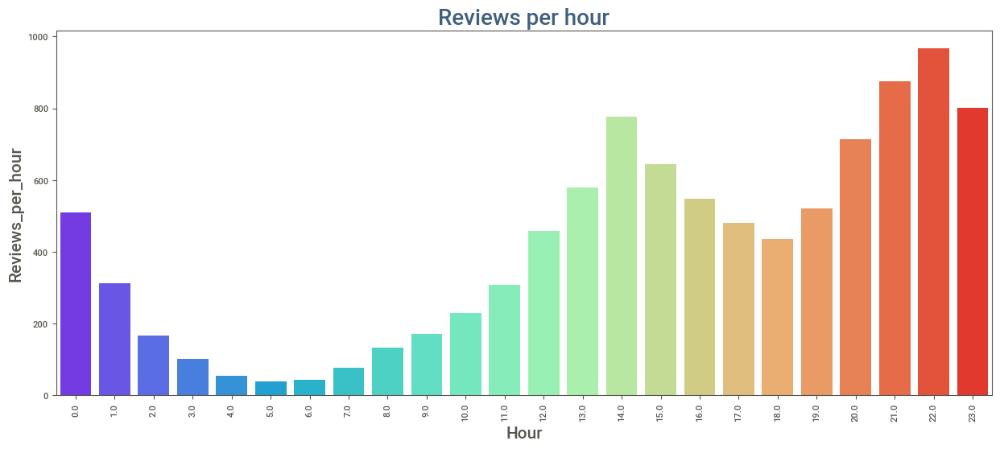

In [76]:
# Chart - 4 visualization code
# plotting reviews per hour
plt.figure(figsize=(15,6))
x = reviews_hour['Hour']
y = reviews_hour['Reviews_per_hour']
plt.title("Reviews per hour",fontsize=20, weight='bold',color=sns.cubehelix_palette(8, start=.5, rot=-.75)[-3])
plt.ylabel("Reviews per hour",weight='bold',fontsize=15)
plt.xlabel("Hour",weight='bold',fontsize=15)
plt.xticks(rotation=90)
sns.barplot(x=x, y=y,palette='rainbow')
plt.show()

##### 2. What is/are the insight(s) found from the chart?

**Here we can see most of the reviews are given between afternoon to night hours. This seems in order as most restaurants' operational time is from late morning upto 11:00 -12:00 pm.**

#### Chart - 5 Create a word cloud for reviews 

(-0.5, 1399.5, 1399.5, -0.5)

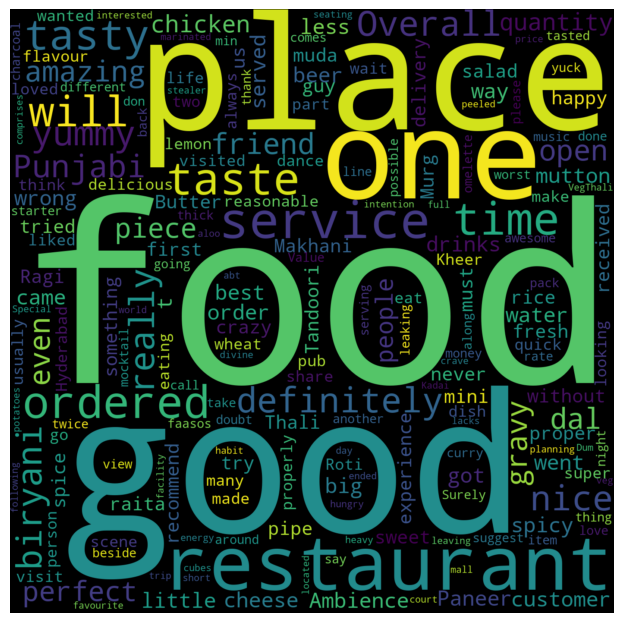

In [77]:
# Chart - 5 visualization code
#Creating word cloud for reviews
plt.figure(figsize=(15,8))
text = " ".join(name for name in df_reviews.sort_values('Review',ascending=False).Review[:30])


# Creating word_cloud with text as argument in .generate() method

word_cloud = WordCloud(width = 1400, height = 1400,collocations = False, background_color = 'black').generate(text)

# Display the generated Word Cloud

plt.imshow(word_cloud, interpolation='bilinear')

plt.axis("off")

##### 1. Why did you pick the specific chart?

**This chart gives us an idea about the words that often occur in the reviews.**

## ***6. Feature Engineering & Data Pre-processing***

### 4. Textual Data Preprocessing 
(It's mandatory for textual dataset i.e., NLP, Sentiment Analysis, Text Clustering etc.)

In [78]:
df_reviews.head(2)

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour
0,0,Beyond Flavours,Rusha Chakraborty,"The ambience was good, food was quite good . had Saturday lunch , which was cost effective .\nGood place for a sate brunch. One can also chill with friends and or parents.\nWaiter Soumen Das was really courteous and helpful.",5.0,2019-05-25 15:54:00,0.0,1.0,2.0,2019.0,5.0,15.0
1,1,Beyond Flavours,Anusha Tirumalaneedi,Ambience is too good for a pleasant evening. Service is very prompt. Food is good. Over all a good experience. Soumen Das - kudos to the service,5.0,2019-05-25 14:20:00,0.0,3.0,2.0,2019.0,5.0,14.0


In [79]:
review=df_reviews.Review
review=list(review)

In [80]:
# Remove the punctuations
df_reviews['Review'] = df_reviews['Review'].str.replace(r'[^\w\s]+', '')

In [81]:
## Removal of Stopwords
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

df_reviews['Review'] = df_reviews['Review'].apply(lambda text: remove_stopwords(text))
df_reviews.sample()

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour
1376,1376,The Lal Street - Bar Exchange,Bhuban Sa,Went place nice place customer service good accepted table booking later I visit place allot table u hit bar counter Note manager u cant provide table dont accept,1.0,2019-03-31 22:30:00,0.0,3.0,7.0,2019.0,3.0,22.0


In [82]:
## Removal of urls
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)

df_reviews['Review'] = df_reviews['Review'].apply(lambda text: remove_urls(text))
df_reviews.sample()

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour
9471,9517,Desi Bytes,Ashish Kumar,Litti chokachicken litti choka dish one go place It drags every time mesmerizes taste buds A plate full ones stomach Taste quite good Quantity sufficient Have tried dishes would love try,3.0,2018-09-23 01:17:00,0.0,2.0,15.0,2018.0,9.0,1.0


In [83]:
df_reviews['Rating'].astype('category').value_counts()

5.0    3826
4.0    2373
1.0    1735
3.0    1192
2.0     684
4.5      69
3.5      47
2.5      19
1.5       9
Name: Rating, dtype: int64

In [84]:
#function to removing words greater than 45 and less than 2
def len_less_than2(review):
  review=" ".join([i for i in review.split() if len(i)>2])
  review=" ".join([i for i in review.split() if len(i)<=45])
  return review

In [85]:
#removing words greater than 45 and less than 2
df_reviews['Review']=df_reviews['Review'].apply(lambda x:len_less_than2(x))

# Sentiment Analysis

In [86]:
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import plotly.express as px

In [87]:
#Create a function to get the subjectivity
def subjectivity(text): 
    return TextBlob(text).sentiment.subjectivity

#Create a function to get the polarity
def polarity(text): 
    return TextBlob(text).sentiment.polarity



In [88]:
#Create two new columns
df_reviews['Subjectivity'] = df_reviews['Review'].apply(subjectivity)
df_reviews['Polarity'] = df_reviews['Review'].apply(polarity)

In [89]:
#Create a function to compute the negative, neutral and positive analysis
def getAnalysis(score):
    if score <0:
        return 'Negative'
    elif score == 0:
        return 'Neutral'
    else:
        return 'Positive'

In [90]:
# plot the polarity and subjectivity
fig = px.scatter(df_reviews, 
                 x='Polarity', 
                 y='Subjectivity', 
                 color = 'Review',
                 size='Subjectivity')

In [91]:
#add a vertical line at x=0 for Netural Reviews
fig.update_layout(title='Sentiment Analysis',
                  shapes=[dict(type= 'line',
                               yref= 'paper', y0= 0, y1= 1, 
                               xref= 'x', x0= 0, x1= 0)])
fig.show()

In [92]:
# Converting Analysis into numeric form Postive=0 and Negative =1
def sentiment(analysis):
  if analysis == 'Positive':
    return 0
  elif analysis == 'Neutral' :
    return 0
    # positive sentiment
  else:
    return 1
    # neagative sentiment 

In [147]:
df_reviews.head(1)

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour,Subjectivity,Polarity
0,0,Beyond Flavours,Rusha Chakraborty,The ambience good food quite good Saturday lunch cost effective Good place sate brunch One also chill friends parents Waiter Soumen Das really courteous helpful,5.0,2019-05-25 15:54:00,0.0,1.0,2.0,2019.0,5.0,15.0,0.72,0.66


# Sentiment Analysis

In [94]:
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import plotly.express as px

#Create a function to get the subjectivity
def subjectivity(text): 
    return TextBlob(text).sentiment.subjectivity

#Create a function to get the polarity
def polarity(text): 
    return TextBlob(text).sentiment.polarity

#Create two new columns
df_reviews['Subjectivity'] = df_reviews['Review'].apply(subjectivity)
df_reviews['Polarity'] = df_reviews['Review'].apply(polarity)

In [95]:
#Create a function to compute the negative, neutral and positive analysis
def getAnalysis(score):
    if score <0:
        return 'Negative'
    elif score == 0:
        return 'Neutral'
    else:
        return 'Positive'
    
    
df_reviews['Analysis'] =df_reviews['Polarity'].apply(getAnalysis)

In [96]:
# plot the polarity and subjectivity
fig = px.scatter(df_reviews, 
                 x='Polarity', 
                 y='Subjectivity', 
                 color = 'Analysis',
                 size='Subjectivity')

#add a vertical line at x=0 for Netural Reviews
fig.update_layout(title='Sentiment Analysis',
                  shapes=[dict(type= 'line',
                               yref= 'paper', y0= 0, y1= 1, 
                               xref= 'x', x0= 0, x1= 0)])
fig.show()

In [97]:
df_reviews.head(3)

,index,Restaurant,Reviewer,Review,Rating,Time,Pictures,Reviews,Followers,Year,Month,Hour,Subjectivity,Polarity,Analysis
0,0,Beyond Flavours,Rusha Chakraborty,The ambience good food quite good Saturday lunch cost effective Good place sate brunch One also chill friends parents Waiter Soumen Das really courteous helpful,5.0,2019-05-25 15:54:00,0.0,1.0,2.0,2019.0,5.0,15.0,0.720000,0.660000,Positive
1,1,Beyond Flavours,Anusha Tirumalaneedi,Ambience good pleasant evening Service prompt Food good Over good experience Soumen Das kudos service,5.0,2019-05-25 14:20:00,0.0,3.0,2.0,2019.0,5.0,14.0,0.691667,0.708333,Positive
2,2,Beyond Flavours,Ashok Shekhawat,must try great food great ambience Thnx service Pradeep Subroto personal recommendation Penne Alfredo Pasta Also music background amazing,5.0,2019-05-24 22:54:00,0.0,2.0,3.0,2019.0,5.0,22.0,0.675000,0.550000,Positive


In [98]:
# Converting Analysis into numeric form Postive=0 and Negative =1
def sentiment(analysis):
  if analysis == 'Positive':
    return 0
  elif analysis == 'Neutral' :
    return 0
    # positive sentiment
  else:
    return 1
    # neagative sentiment 
    

df_reviews['Reviews']=df_reviews['Reviews'].apply(lambda x:sentiment(x))

sentiment_df=df_reviews[['Review','Rating','Analysis']]
sentiment_df.head(10)

,Review,Rating,Analysis
0,The ambience good food quite good Saturday lunch cost effective Good place sate brunch One also chill friends parents Waiter Soumen Das really courteous helpful,5.0,Positive
1,Ambience good pleasant evening Service prompt Food good Over good experience Soumen Das kudos service,5.0,Positive
2,must try great food great ambience Thnx service Pradeep Subroto personal recommendation Penne Alfredo Pasta Also music background amazing,5.0,Positive
3,Soumen das Arun great guy Only behavior sincerety And good food course would like visit place,5.0,Positive
4,Food goodwe ordered Kodi drumsticks basket mutton biryani All good Thanks Pradeep served well enjoyed Ambience also good,5.0,Positive
5,Ambiance good service good food aPradeecp subro best service Food good Papiya good hostess caption good This 4star restaurant,5.0,Positive
6,Its nice place ambience different food ordered tasty service also gud worth visit Its reasonable well Really must visit place,5.0,Positive
7,Well reading many reviews finally visited placeambience good coming food crispy corn nice Tawa fish Basket Biryani disappointed biryani flattering claimed Staff polite prompt especially pradeep Suman,4.0,Positive
8,Excellent food specially like spicy food Courteous staff Shubro pradeep papiya gave excellent service corporate team dinner Overall great team dinners party,5.0,Positive
9,Came birthday treat close friend Perfect place treat like Very hospitable cooperative staff Food delicious ambience really good music lighting Chili honey lotus stem must try Special mention Papiya took good care,5.0,Positive


### 8. Data Splitting

In [99]:
# Split your data to train and test. Choose Splitting ratio wisely.
X = sentiment_df['Review']
y = sentiment_df['Analysis']

from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.25,stratify=sentiment_df['Analysis'])



In [100]:
# creating tokens for text data
from sklearn.feature_extraction.text import  TfidfVectorizer
vectorizer = TfidfVectorizer()
X_train= vectorizer.fit_transform(X_train)
X_test=vectorizer.transform(X_test)

## ***7. ML Model Implementation***

In [103]:
def model_details(y_train, y_test, y_pred_train, y_pred_test):
  # Accuracy
  print('-'*50)
  train_accuracy = accuracy_score(y_train,y_pred_train)
  print('Train accuracy is:',train_accuracy)
  test_accuracy = accuracy_score(y_test,y_pred_test)
  print('Test accuracy is:',test_accuracy)
  print('-'*50)
  confusion_mat = confusion_matrix(y_pred_test, y_test)
  print("The confusion matrix on the test data is :")
  print(confusion_mat)
  print('-'*50)
  classification_rep= classification_report(y_pred_test, y_test)
  
  print("The classification report on the train data is :")
  print(classification_rep)

### ML Model - Naive Bayes 

In [101]:
from sklearn.metrics import accuracy_score, confusion_matrix,roc_auc_score, classification_report, f1_score
from sklearn.naive_bayes import MultinomialNB
# creating MultinomialNB model
model = MultinomialNB()
model.fit(X_train,y_train)

MultinomialNB()

In [102]:
#predicting the values of y from x via model
y_pred_test = model.predict(X_test)
y_pred_train = model.predict(X_train)

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [104]:
model_details(y_train, y_test, y_pred_train, y_pred_test)

--------------------------------------------------
Train accuracy is: 0.7902210314802411
Test accuracy is: 0.7721976697468863
--------------------------------------------------
The confusion matrix on the test data is :
[[  43    1    1]
 [   0    0    0]
 [ 430  135 1879]]
--------------------------------------------------
The classification report on the train data is :
              precision    recall  f1-score   support

    Negative       0.09      0.96      0.17        45
     Neutral       0.00      0.00      0.00         0
    Positive       1.00      0.77      0.87      2444

    accuracy                           0.77      2489
   macro avg       0.36      0.57      0.35      2489
weighted avg       0.98      0.77      0.86      2489



### ML Model - 2 Random Forests

In [105]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

rf= RandomForestClassifier()

grid_values_rf = {'n_estimators': [100,150],'max_depth': [10,15],'criterion': ['entropy']}
rfc = GridSearchCV(estimator=rf,param_grid = grid_values_rf, scoring='recall',cv=5,verbose=5,n_jobs=-1)

rfc.fit(X_train, y_train)

Fitting 5 folds for each of 4 candidates, totalling 20 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'], 'max_depth': [10, 15],
                         'n_estimators': [100, 150]},
             scoring='recall', verbose=5)

In [106]:
random_y_pred_train=rfc.predict(X_train)
random_y_pred_test=rfc.predict(X_test)

In [107]:
model_details(y_train, y_test, random_y_pred_train, random_y_pred_test)

--------------------------------------------------
Train accuracy is: 0.7556597454789016
Test accuracy is: 0.7553234230614705
--------------------------------------------------
The confusion matrix on the test data is :
[[   0    0    0]
 [   0    0    0]
 [ 473  136 1880]]
--------------------------------------------------
The classification report on the train data is :
              precision    recall  f1-score   support

    Negative       0.00      0.00      0.00         0
     Neutral       0.00      0.00      0.00         0
    Positive       1.00      0.76      0.86      2489

    accuracy                           0.76      2489
   macro avg       0.33      0.25      0.29      2489
weighted avg       1.00      0.76      0.86      2489



### ML Model - 3 xgboost

In [108]:
from xgboost import XGBClassifier
xgbc=XGBClassifier()


#### Tunning the hyperparameters

In [109]:
# finding the best parameters for XGBRegressor by gridsearchcv
xgbc_param={'n_estimators': [100,125,150],'max_depth': [7,10,15],'criterion': ['entropy']}
xgbc_grid=GridSearchCV(estimator=xgbc,param_grid=xgbc_param,cv=3,scoring='recall',verbose=5,n_jobs=-1)

In [110]:
#### 2. Cross- Validation & Hyperparameter Tuning
xgbc_grid.fit(X_train, y_train)

Fitting 3 folds for each of 9 candidates, totalling 27 fits
[09:48:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:576: 
Parameters: { "criterion" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[09:48:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     enable_categorical=False, gamma=None,
                                     gpu_id=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, predictor=None,
                                     random_state=None, reg_alpha=None,
                                     reg_lambda=None, scale_pos_weight=None,
                                     subsample=None, tree_method=None,
                                     validate_parameters=None, verbosity=None),
             n_jobs=-1,
             param_grid={'criterion': ['entropy'], 'max_depth': [7, 10, 15],
                         'n_estimators': [100, 125, 150]},
             scoring='recall', verbose=5)

In [111]:
xgb_y_pred_train=xgbc_grid.predict(X_train)
xgb_y_pred_test=xgbc_grid.predict(X_test)

In [112]:
model_details(y_train, y_test, xgb_y_pred_train, xgb_y_pred_test)

--------------------------------------------------
Train accuracy is: 0.99410582719357
Test accuracy is: 0.9341100843712334
--------------------------------------------------
The confusion matrix on the test data is :
[[ 381    8   46]
 [   8  119    9]
 [  84    9 1825]]
--------------------------------------------------
The classification report on the train data is :
              precision    recall  f1-score   support

    Negative       0.81      0.88      0.84       435
     Neutral       0.88      0.88      0.88       136
    Positive       0.97      0.95      0.96      1918

    accuracy                           0.93      2489
   macro avg       0.88      0.90      0.89      2489
weighted avg       0.94      0.93      0.94      2489



In [118]:
result = xgbc_grid.best_estimator_

Answer Here.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

## **We can see significant improvement in Evaluation metrics with xgboost model. Thus, we choose xgboost model as the final model**

### 2. Which ML model did you choose from the above created models as your final prediction model and why?

In [169]:
from sklearn.tree import export_graphviz
from sklearn.tree import DecisionTreeClassifier
import shap 
import graphviz
sns.set_style('darkgrid')
import xgboost

from xgboost import XGBRegressor
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

In [139]:
df=sentiment_df.copy()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9954 entries, 0 to 9953
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Review    9954 non-null   object 
 1   Rating    9954 non-null   float64
 2   Analysis  9954 non-null   object 
dtypes: float64(1), object(2)
memory usage: 233.4+ KB


In [142]:
df.columns

Index(['Review', 'Rating', 'Analysis'], dtype='object')

In [149]:
!pip install --user --upgrade pip

In [170]:

import eli5 as eli

In [154]:
xgbc.fit(X_train,y_train)

[20:35:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=2,
              num_parallel_tree=1, objective='multi:softprob', predictor='auto',
              random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=None,
              subsample=1, tree_method='exact', validate_parameters=1,
              verbosity=None)

In [155]:
eli.explain_weights(xgbc)

Weight,Feature
0.0340,f15604
0.0187,f789
0.0185,f1443
0.0151,f1773
0.0149,f9402
0.0136,f6071
0.0134,f1368
0.0129,f10293
0.0128,f6242
0.0112,f8279


### 3. Explain the model which you have used and the feature importance using any model explainability tool?

## We have used eli5 Model explainability tool here.

## ***8.*** ***Future Work (Optional)***

### 1. Save the best performing ml model in a pickle file or joblib file format for deployment process.


In [113]:
# Save the File
# Save the File
import pickle

model_filename = "xgbc_grid.sav"

saved_model = pickle.dump(xgbc_grid, open(model_filename,'wb'))

print('Model is saved into to disk successfully Using Pickle')

Model is saved into to disk successfully Using Pickle


### 2. Again Load the saved model file and try to predict unseen data for a sanity check.


In [166]:
# Load the File and predict unseen data.
pickled_model = pickle.load(open('xgbc_grid.sav', 'rb'))
pickled_model.predict(X_test)

array(['Positive', 'Negative', 'Positive', ..., 'Positive', 'Negative',
       'Positive'], dtype=object)

### ***Congrats! Your model is successfully created and ready for deployment on a live server for a real user interaction !!!***

# **CLUSTERING**

In [177]:
df_onee=pd.read_csv("zomatodata.csv")

In [178]:
df_onee['Cuisines'] = df_onee['Cuisines'].apply(lambda x : x.lower())

In [179]:
cuisine_df=df_onee.loc[:,['Name','Cost','Cuisines']]

In [180]:
cuisine_df.head()

,Name,Cost,Cuisines
0,Beyond Flavours,800,"chinese, continental, kebab, european, south indian, north indian"
1,Paradise,800,"biryani, north indian, chinese"
2,Flechazo,"1,300","asian, mediterranean, north indian, desserts"
3,Shah Ghouse Hotel & Restaurant,800,"biryani, north indian, chinese, seafood, beverages"
4,Over The Moon Brew Company,"1,200","asian, continental, north indian, chinese, mediterranean"


In [182]:
cuisine_df['Cuisines'] = cuisine_df['Cuisines'].str.replace(' ','')

cuisine_df['Cuisines'] = cuisine_df['Cuisines'].str.split(',')

### Let us create one hot encoded labels for each type of cuisines and dropping the cuisine column

In [183]:
from sklearn.preprocessing import MultiLabelBinarizer

mlb = MultiLabelBinarizer(sparse_output=True)

In [184]:
cuisine_df = cuisine_df.join(pd.DataFrame.sparse.from_spmatrix(mlb.fit_transform(cuisine_df.pop('Cuisines')),
                                                               index=cuisine_df.index, columns=mlb.classes_))

In [186]:
# Remove nan rating in Rating column
df_reviews.dropna(subset=['Rating'],inplace=True)

### There was on rating 'Like' so we can change it into 4, because 4 is not in Rating column

In [187]:
df_reviews['Rating'] = df_reviews['Rating'].replace('Like', '4')

In [189]:
# Change data type of rating column to float
df_reviews['Rating']= df_reviews['Rating'].astype('float')

df_reviews.dropna(subset =['Review'], inplace=True)

ratings_df  = df_reviews.groupby('Restaurant')['Rating'].mean().reset_index()

ratings_df .sort_values(by='Rating',ascending = False).head(15)


,Restaurant,Rating
3,AB's - Absolute Barbecues,4.880
11,B-Dubs,4.810
2,"3B's - Buddies, Bar & Barbecue",4.760
67,Paradise,4.700
35,Flechazo,4.660
87,The Indi Grill,4.600
97,Zega - Sheraton Hyderabad Hotel,4.450
64,Over The Moon Brew Company,4.340
16,Beyond Flavours,4.280
19,Cascade - Radisson Hyderabad Hitec City,4.260


## Let us merge two dataframes, so that we can use the one for clustering

In [190]:
df_cluster = cuisine_df.merge(ratings_df, left_on='Name',right_on='Restaurant')

In [191]:
df_cluster.head(3)

,Name,Cost,american,andhra,arabian,asian,bakery,bbq,beverages,biryani,...,salad,seafood,southindian,spanish,streetfood,sushi,thai,wraps,Restaurant,Rating
0,Beyond Flavours,800,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,Beyond Flavours,4.28
1,Paradise,800,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,Paradise,4.70
2,Flechazo,"1,300",0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,Flechazo,4.66


## change names and order of the columns


In [192]:
df_cluster = df_cluster[['Name', 'Cost','Rating', 'american', 'andhra', 'arabian', 'asian', 'bbq',
       'bakery', 'beverages', 'biryani', 'burger', 'cafe', 'chinese',
       'continental', 'desserts', 'european', 'fastfood', 'fingerfood', 'goan',
       'healthyfood', 'hyderabadi', 'icecream', 'indonesian', 'italian',
       'japanese', 'juices', 'kebab', 'lebanese', 'malaysian', 'mediterranean',
       'mexican', 'mithai', 'modernindian', 'momos', 'mughlai', 'northeastern',
       'northindian', 'pizza', 'salad', 'seafood', 'southindian', 'spanish',
       'streetfood', 'sushi', 'thai', 'wraps']]

In [193]:
df_cluster.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100 entries, 0 to 99
Data columns (total 47 columns):
 #   Column         Non-Null Count  Dtype           
---  ------         --------------  -----           
 0   Name           100 non-null    object          
 1   Cost           100 non-null    object          
 2   Rating         100 non-null    float64         
 3   american       100 non-null    Sparse[int32, 0]
 4   andhra         100 non-null    Sparse[int32, 0]
 5   arabian        100 non-null    Sparse[int32, 0]
 6   asian          100 non-null    Sparse[int32, 0]
 7   bbq            100 non-null    Sparse[int32, 0]
 8   bakery         100 non-null    Sparse[int32, 0]
 9   beverages      100 non-null    Sparse[int32, 0]
 10  biryani        100 non-null    Sparse[int32, 0]
 11  burger         100 non-null    Sparse[int32, 0]
 12  cafe           100 non-null    Sparse[int32, 0]
 13  chinese        100 non-null    Sparse[int32, 0]
 14  continental    100 non-null    Sparse[int32

In [194]:
df_cluster['Cost']= df_cluster['Cost'].str.replace(',','')

In [195]:
df_cluster['Cost']= df_cluster['Cost'].astype('float')

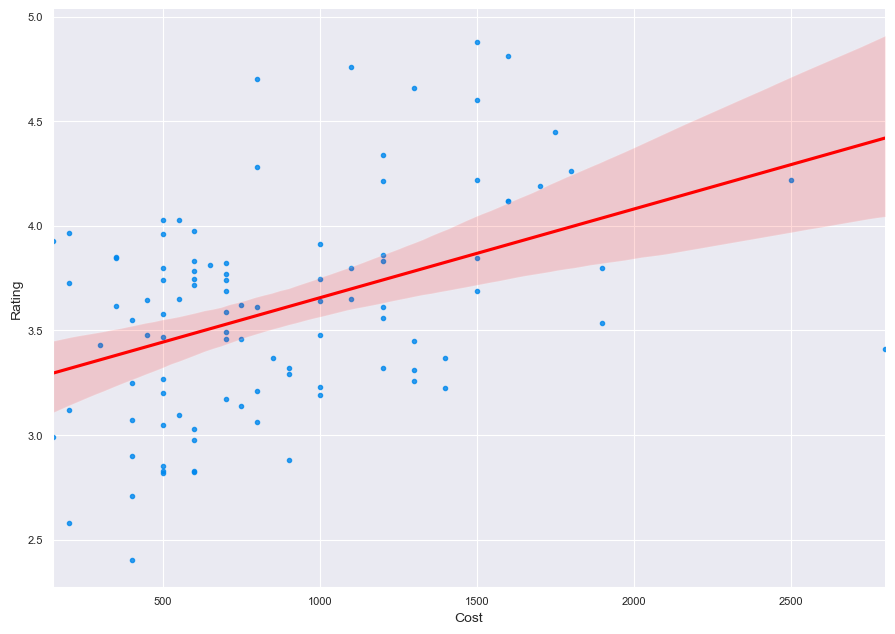

In [196]:
sns.lmplot(y='Rating',x='Cost',data=df_cluster,line_kws={'color' :'red'},height=6.27, aspect=11.7/8.27)

# K Means Clustering

In [197]:
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer




Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

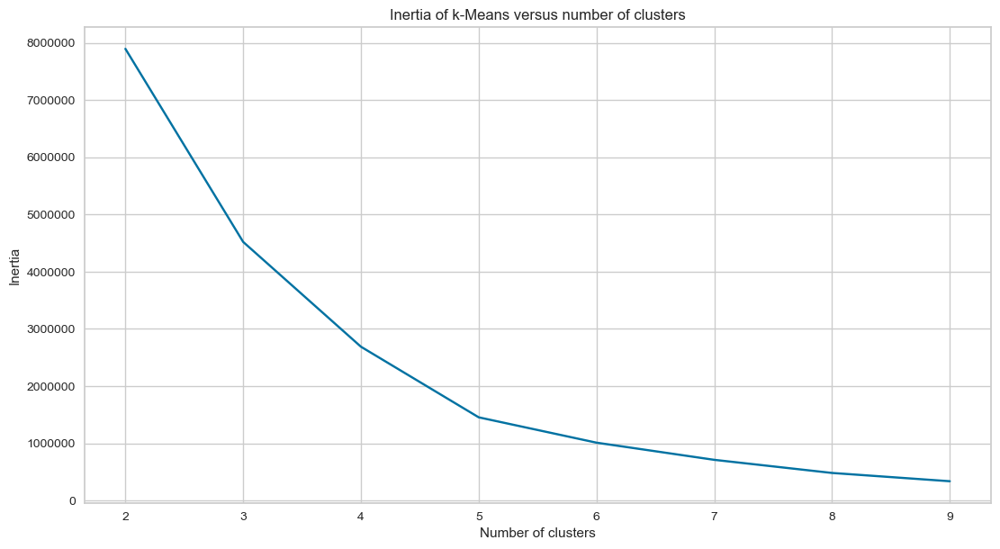

In [198]:
scores = [KMeans(n_clusters=i+2, random_state=11).fit(df_cluster.drop('Name',axis =1)).inertia_ 
          for i in range(8)]
plt.figure(figsize=(13,7))
sns.lineplot(np.arange(2, 10), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [199]:
# let us take 5 as initial cluster number
model = KMeans(random_state=11, n_clusters=5)
model.fit(df_cluster.drop('Name',axis=1))

KMeans(n_clusters=5, random_state=11)

In [200]:
cluster_lbl = model.predict(df_cluster.drop('Name',axis=1))

In [201]:
df_cluster['labels'] = cluster_lbl

Text(0.5, 0, 'Cost')

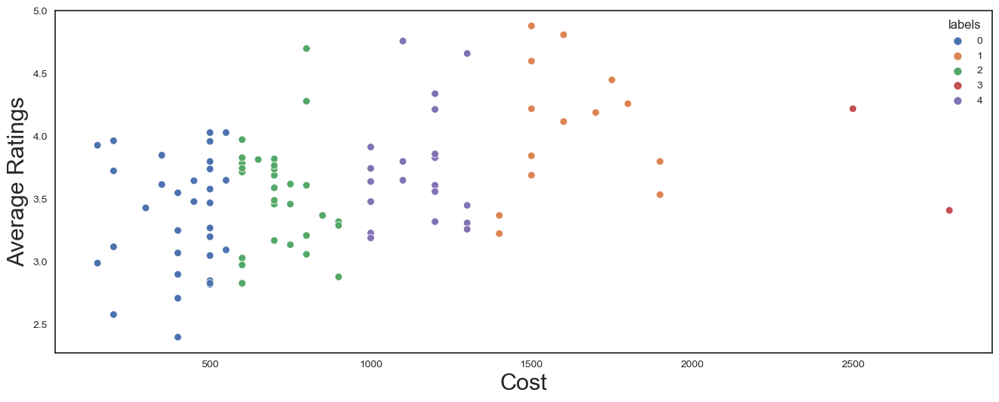

In [202]:
plt.figure(figsize = (16,6))
sns.set_style('white')
sns.scatterplot(y='Rating',x='Cost',data=df_cluster,hue='labels', palette = 'deep')
plt.ylabel('Average Ratings',fontdict={'size':22})
plt.xlabel('Cost',fontdict={'size':22})

In [203]:
cluster_0 = df_cluster[df_cluster['labels'] == 0].reset_index()
cluster_1 = df_cluster[df_cluster['labels'] == 1].reset_index()
cluster_2 = df_cluster[df_cluster['labels'] == 2].reset_index()
cluster_3 = df_cluster[df_cluster['labels'] == 3].reset_index()
cluster_4 = df_cluster[df_cluster['labels'] == 4].reset_index()

In [204]:
list_of_cluster=[cluster_0,cluster_1,cluster_2,cluster_3,cluster_4]

In [205]:
# Top cuisines in each cluster
for i,df in enumerate(list_of_cluster):
  print(f'Top cuisines in cluster {i}\n', df.drop(['index','Name','Cost','Rating','labels'],axis=1).sum().sort_values(ascending=False)[:3],'\n')

Top cuisines in cluster 0
 northindian    16
chinese         9
fastfood        8
dtype: int32 

Top cuisines in cluster 1
 northindian    11
continental     6
asian           5
dtype: int32 

Top cuisines in cluster 2
 northindian    18
chinese        18
biryani        11
dtype: int32 

Top cuisines in cluster 3
 asian          2
italian        2
continental    2
dtype: int32 

Top cuisines in cluster 4
 northindian    14
chinese         9
italian         7
dtype: int32 



# Here we can see that NorthIndian and Chinese are the prominent cuisines across all clusters.

# Principal Component Analysis **(PCA)**

In [206]:
scaler = MinMaxScaler()
X = scaler.fit_transform(df_cluster.drop('Name',axis =1))

In [207]:
from sklearn.decomposition import PCA
pca = PCA(n_components=4)

In [208]:
X_pca = pca.fit_transform(X)

In [209]:
pca.components_

array([[-9.62465184e-02,  9.57677203e-03,  5.92680890e-02,
        -8.10689184e-02,  3.22812540e-03, -2.36603488e-02,
         1.13211710e-02,  1.00058721e-01,  6.13264813e-02,
        -1.81108063e-01,  9.94861590e-02,  1.45240528e-01,
        -5.39620575e-01, -1.45098514e-01,  2.97973008e-01,
        -2.13659614e-02,  2.61045926e-01, -2.35456513e-02,
        -4.90616615e-03, -3.85997936e-03, -2.72274416e-02,
         4.55328901e-02, -6.60734334e-05, -1.28450123e-01,
        -1.69161056e-02, -1.37358749e-02, -6.42034081e-02,
         1.54018096e-02, -0.00000000e+00, -2.38269280e-02,
        -1.88773107e-02, -0.00000000e+00,  1.71550564e-02,
         3.05312331e-02, -2.98963405e-02,  1.59082163e-02,
        -5.94759828e-01,  2.12156286e-02, -1.72169962e-02,
        -4.20780032e-02, -1.00232235e-01,  3.60174653e-03,
         2.38269176e-02, -6.54165803e-03, -1.92912307e-03,
         2.33622022e-02, -1.92739252e-01],
       [ 2.32279349e-01,  1.68080983e-01, -3.87599307e-03,
        -1.22

Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

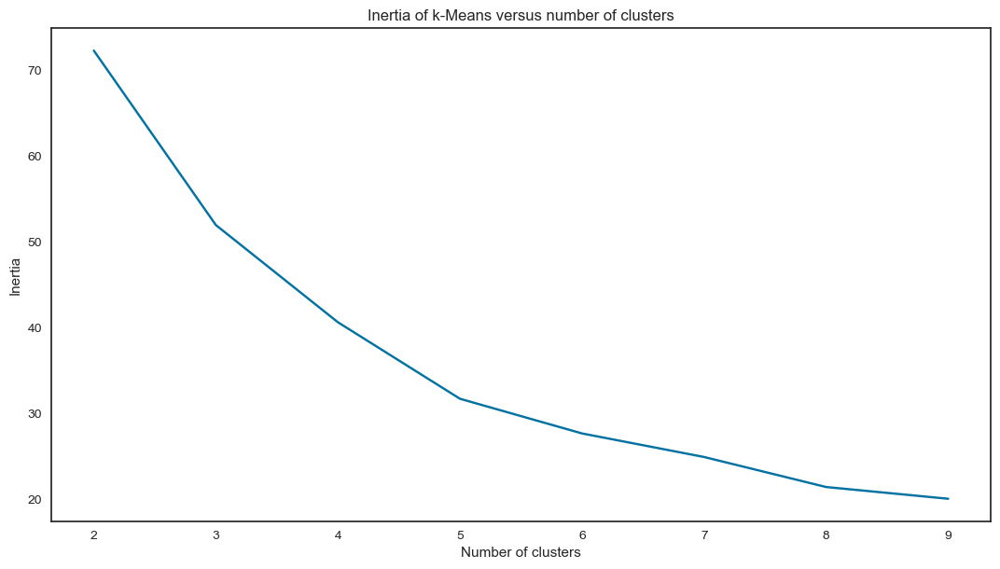

In [210]:
scores1 = [KMeans(n_clusters=i+2, random_state=11).fit(X_pca).inertia_ 
          for i in range(8)]
plt.figure(figsize=(13,7))
sns.lineplot(np.arange(2, 10), scores1)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

In [211]:
model1 = KMeans(random_state=11, n_clusters=5)
model1.fit(X_pca)

KMeans(n_clusters=5, random_state=11)

In [212]:
cluster_labels = model1.predict(X_pca)

In [213]:
# Making label column
df_cluster['labels'] = cluster_labels

Text(0.5, 0, 'PC1')

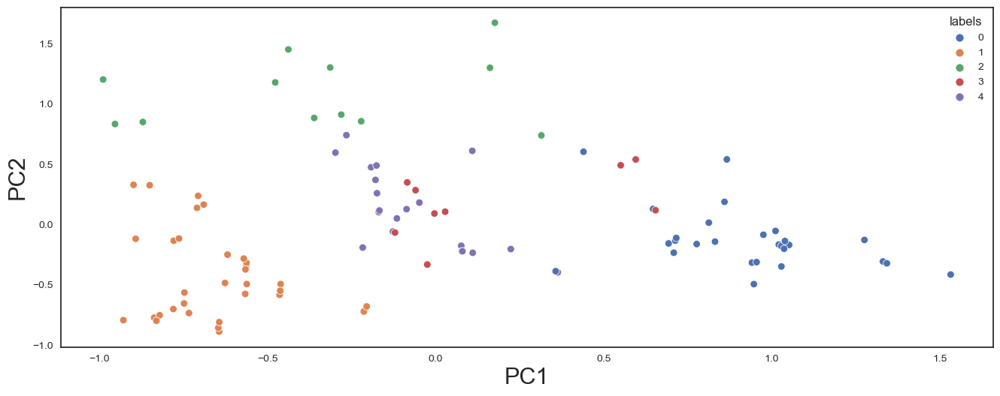

In [214]:
plt.figure(figsize = (16,6))
sns.set_style('white')
sns.scatterplot(y=X_pca[:,1],x=X_pca[:,0],data=df_cluster,hue='labels', palette = 'deep')
plt.ylabel('PC2',fontdict={'size':22})
plt.xlabel('PC1',fontdict={'size':22})

In [215]:
df_0 = df_cluster[df_cluster['labels'] == 0].reset_index()
df_1 = df_cluster[df_cluster['labels'] == 1].reset_index()
df_2 = df_cluster[df_cluster['labels'] == 2].reset_index()
df_3 = df_cluster[df_cluster['labels'] == 3].reset_index()
df_4 = df_cluster[df_cluster['labels'] == 4].reset_index()

In [216]:
list_of_df = [df_0,df_1,df_2,df_3,df_4]

In [217]:
# Most Prominent cuisines in each cluster(Top 5)
for i,df in enumerate(list_of_df):
  print(f'Top Cuisines in Cluster {i} \n', df.drop(['index','Name','Cost','Rating','labels'],axis = 1).sum().sort_values(ascending=False)[:3],'\n')

Top Cuisines in Cluster 0 
 desserts    12
fastfood    10
cafe         6
dtype: int32 

Top Cuisines in Cluster 1 
 northindian    32
chinese        31
biryani        13
dtype: int32 

Top Cuisines in Cluster 2 
 continental    12
italian         9
northindian     8
dtype: int32 

Top Cuisines in Cluster 3 
 asian      6
chinese    6
thai       2
dtype: int32 

Top Cuisines in Cluster 4 
 northindian      20
mediterranean     4
southindian       4
dtype: int32 



# ***Conclusion***
# We notice that after applying the PCA and scaling the data with MinMaxSclear, cuisines are well differentiated amongst clusters.

### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***